This notebook loads the pickled dictionary with the presidents' raw and aggregated popularity, concatenates the raw popularity of each one, and saves all these data in a unique CSV file for sharing

In [1]:
import arviz as az
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pymc3 as pm
import xarray as xr

from scipy.special import expit as logistic

In [2]:
%config InlineBackend.figure_format = 'retina'
RANDOM_SEED = 8927
np.random.seed(RANDOM_SEED)
az.style.use('arviz-darkgrid')

In [3]:
PARTIES = {
    "chirac2": "right",
    "sarkozy": "right",
    "hollande": "left",
    "macron": "center",
}

def standardize(series):
    """Standardize a pandas series"""
    return (series - series.mean()) / series.std()

In [4]:
all_presidents = pd.read_excel(
    "../data/raw_popularity_presidents.xlsx", index_col=0, parse_dates=True
)
all_presidents

,president,sondage,samplesize,method,approve_pr,disapprove_pr
1978-09-28,vge,Kantar,1040,face to face,60.0,33.0
1978-10-17,vge,Ifop,949,phone,52.0,35.0
1978-10-28,vge,Kantar,964,face to face,59.0,34.0
1978-11-19,vge,Ifop,1069,phone,53.0,37.0
1978-11-24,vge,Kantar,928,face to face,62.0,33.0
...,...,...,...,...,...,...
2020-07-10,macron,Ifop,1018,internet,38.0,62.0
2020-07-16,macron,BVA,1000,internet,39.0,61.0
2020-07-16,macron,Ifop,974,internet,37.0,63.0
2020-07-22,macron,Harris,960,internet,50.0,50.0


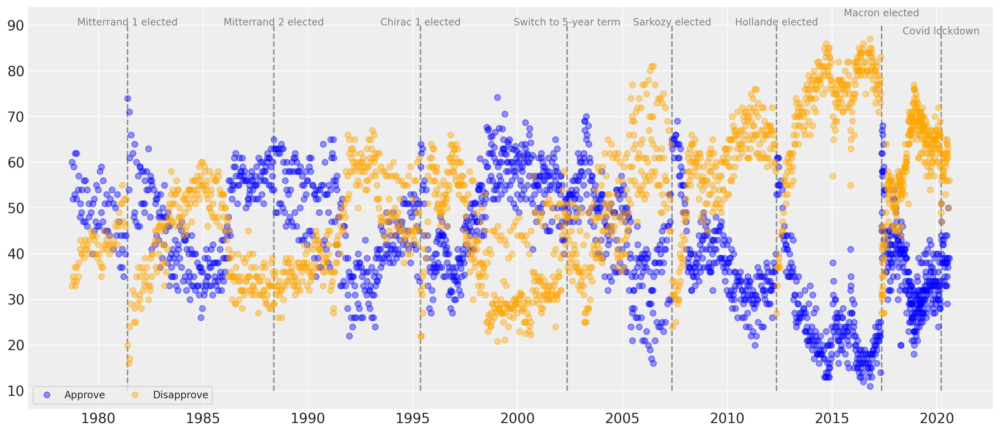

In [6]:
_, ax = plt.subplots(1, 1, figsize=(14, 6))

ax.plot(
    all_presidents.index, all_presidents.approve_pr, "ob", label="Approve", alpha=0.4
)
ax.plot(
    all_presidents.index,
    all_presidents.disapprove_pr,
    "o",
    color="orange",
    label="Disapprove",
    alpha=0.4,
)

ax.vlines(pd.to_datetime("1981-05-25"), 10, 90, "k", "--", alpha=0.4)
ax.text(
    pd.to_datetime("1981-05-25"),
    90,
    "Mitterrand 1 elected",
    fontsize=10,
    color="grey",
    horizontalalignment="center",
)

ax.vlines(pd.to_datetime("1988-05-16"), 10, 90, "k", "--", alpha=0.4)
ax.text(
    pd.to_datetime("1988-05-16"),
    90,
    "Mitterrand 2 elected",
    fontsize=10,
    color="grey",
    horizontalalignment="center",
)

ax.vlines(pd.to_datetime("1995-05-18"), 10, 90, "k", "--", alpha=0.4)
ax.text(
    pd.to_datetime("1995-05-18"),
    90,
    "Chirac 1 elected",
    fontsize=10,
    color="grey",
    horizontalalignment="center",
)

ax.vlines(pd.to_datetime("2002-05-14"), 10, 90, "k", "--", alpha=0.4)
ax.text(
    pd.to_datetime("2002-05-14"),
    90,
    "Switch to 5-year term",
    fontsize=10,
    color="grey",
    horizontalalignment="center",
)

ax.vlines(pd.to_datetime("2007-05-16"), 10, 90, "k", "--", alpha=0.4)
ax.text(
    pd.to_datetime("2007-05-16"),
    90,
    "Sarkozy elected",
    fontsize=10,
    color="grey",
    horizontalalignment="center",
)

ax.vlines(pd.to_datetime("2012-05-11"), 10, 90, "k", "--", alpha=0.4)
ax.text(
    pd.to_datetime("2012-05-11"),
    90,
    "Hollande elected",
    fontsize=10,
    color="grey",
    horizontalalignment="center",
)

ax.vlines(pd.to_datetime("2017-05-17"), 10, 90, "k", "--", alpha=0.4)
ax.text(
    pd.to_datetime("2017-05-17"),
    92,
    "Macron elected",
    fontsize=10,
    color="grey",
    horizontalalignment="center",
)

ax.vlines(pd.to_datetime("2020-03-17"), 10, 90, "k", "--", alpha=0.4)
ax.text(
    pd.to_datetime("2020-03-17"),
    88,
    "Covid lockdown",
    fontsize=10,
    color="grey",
    horizontalalignment="center",
)

plt.legend(fontsize=10, ncol=2, loc="lower left", frameon=True);

In [5]:
# restrict data to after the switch to 5-year term
d = all_presidents.loc[all_presidents.index >= pd.to_datetime("2002-05-05")]
# d = all_presidents[(all_presidents.president == "macron") | (all_presidents.president == "hollande")]

# convert to proportions
d[["approve_pr", "disapprove_pr"]] = d[["approve_pr", "disapprove_pr"]].copy() / 100
d = d.rename(columns={"approve_pr": "p_approve", "disapprove_pr": "p_disapprove"})

# raw monthly average to get fixed time intervals
d = d.groupby("president").resample("M").mean().reset_index(level=0).sort_index()

d["party"] = d.president.replace(PARTIES)

/Users/alex_andorra/opt/anaconda3/envs/elections-models/lib/python3.8/site-packages/pandas/core/frame.py:2963: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


In [6]:
ELECTION_FLAGS = (
    (d.index.year == 2002) & (d.index.month == 5)
    | (d.index.year == 2007) & (d.index.month == 5)
    | (d.index.year == 2012) & (d.index.month == 5)
    | (d.index.year == 2017) & (d.index.month == 5)
)
d["election_flag"] = 0
d.loc[ELECTION_FLAGS, "election_flag"] = 1

# convert to nbr of successes
d["N_approve"] = d.samplesize * d["p_approve"]
d["N_disapprove"] = d.samplesize * d["p_disapprove"]
d[["N_approve", "N_disapprove"]] = d[["N_approve", "N_disapprove"]].round().astype(int)

# compute total trials
d["N_total"] = d.N_approve + d.N_disapprove
d

,president,samplesize,p_approve,p_disapprove,party,election_flag,N_approve,N_disapprove,N_total
2002-05-31,chirac2,964.250000,0.502500,0.442500,right,1,485,427,912
2002-06-30,chirac2,970.000000,0.505000,0.425000,right,0,490,412,902
2002-07-31,chirac2,947.333333,0.533333,0.406667,right,0,505,385,890
2002-08-31,chirac2,1028.000000,0.520000,0.416667,right,0,535,428,963
2002-09-30,chirac2,1017.500000,0.525000,0.420000,right,0,534,427,961
...,...,...,...,...,...,...,...,...,...
2020-04-30,macron,1174.400000,0.406000,0.582000,center,0,477,684,1161
2020-05-31,macron,1126.428571,0.371429,0.594286,center,0,418,669,1087
2020-06-30,macron,1124.714286,0.362857,0.612857,center,0,408,689,1097
2020-07-31,macron,991.200000,0.398000,0.602000,center,0,394,597,991


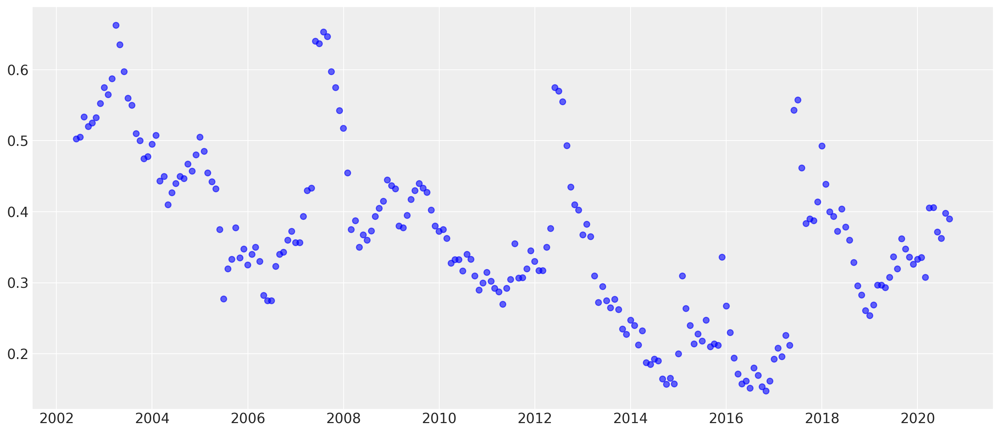

In [8]:
_, ax = plt.subplots(1, 1, figsize=(14, 6))
ax.plot(d.index, d.p_approve, "ob", label="Approve", alpha=0.6);

In [7]:
def dates_to_idx(timelist):
    """Convert datetimes to numbers in reference to a given date. Useful for posterior predictions."""

    reference_time = timelist[0]
    t = (timelist - reference_time) / np.timedelta64(1, "M")

    return np.asarray(t)

In [8]:
time = dates_to_idx(d.index)
time[:10]

array([0.        , 0.98564652, 2.00414793, 3.02264934, 4.00829586,
       5.02679726, 6.01244379, 7.03094519, 8.0494466 , 8.96938335])

Priors are very important to fit GPs properly, so let's spend some time thinking about our priors for a more refined model of the popularity of the president. We start by the priors for the lengthscale and period parameters:
- `ls_trend`: The lengthscale of the long term trend. It has a wide prior with most of the mass between 1 to 3 years.
- `ls_med`: This is the lengthscale for the short to medium long variations. This prior has most of its mass below 2 years.
- `scale_mixture_rate` of the Rational Quadratic kernel: It is equivalent to using a combination of Exponential Quadratic kernels with different length scales. As the scale mixture rate approaches infinity, the kernel becomes exactly equivalent to the Exponential Quadratic Kernel. We center the prior for this parameter around 3, since we’re expecting that there is some more variation than could be explained by an exponentiated quadratic kernel.
- `period` of the semi-periodic component: We don't have a strong prior on this, so we'll center the period at one year, with the possibility for short-term seasonality as well as longer seasonality.
- `ls_period`: The smoothness of the semi-periodic component. It controls how “sinusoidal” the periodicity is. The plot of the data shows that seasonality is quite far from a sine wave, so we use a Gamma whose mode is at 2, and a relatively large variance.
- `ls_period_decay`: The periodic decay. The smaller this parameter, the faster the periodicity goes away. I suspect the seasonality of popularity goes away quite quickly, so let's put most of the prior mass between 6 months and 2 years.

If you're a bit lost, that's quite normal: parameters for GPs are not easily interpretable so it takes some time to develop intuition about them -- all the more so because the Gamma distribution is very flexible, so it can take _a lot_ of different shapes. Here are good educational ressources to think about priors in the context of GPs:
- PyMC3's CO2 at Mauna Loa [example notebook](https://docs.pymc.io/notebooks/GP-MaunaLoa.html).
- PyMC3's notebook for [mean and covariance functions](https://docs.pymc.io/notebooks/GP-MeansAndCovs.html).
- PyMC4's notebook for [mean and covariance functions](https://github.com/pymc-devs/pymc4/blob/master/notebooks/GP-Kernels.ipynb).
- Michael Betancourt's ["Probabilistic Building Blocks"](https://betanalpha.github.io/assets/case_studies/probability_densities.html#25_the_gamma_family) case-study.

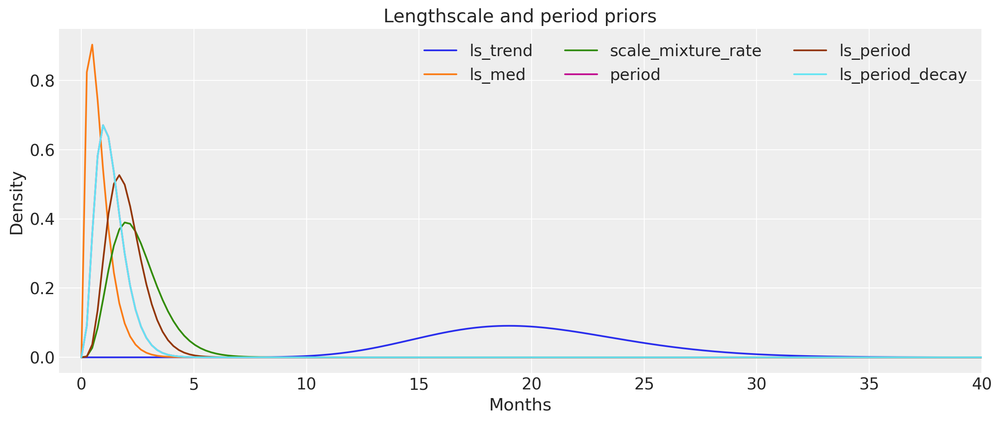

In [11]:
x = np.linspace(0, 120, 500)
priors = [
    ("ls_trend", pm.Gamma.dist(alpha=20, beta=1)),
    ("ls_med", pm.Gamma.dist(alpha=2, beta=2.5)),
    ("scale_mixture_rate", pm.Gamma.dist(alpha=5, beta=2)),
    ("period", pm.Gamma.dist(alpha=4, beta=3)),
    ("ls_period", pm.Gamma.dist(alpha=6, beta=3)),
    ("ls_period_decay", pm.Gamma.dist(alpha=4, beta=3)),
]

fig = plt.figure(figsize=(12, 5))

for i, prior in enumerate(priors):
    plt.plot(x, np.exp(prior[1].logp(x).eval()), label=prior[0])

plt.xlim((-1, 40))
plt.xlabel("Months")
plt.ylabel("Density")
plt.title("Lengthscale and period priors")
plt.legend(ncol=3);

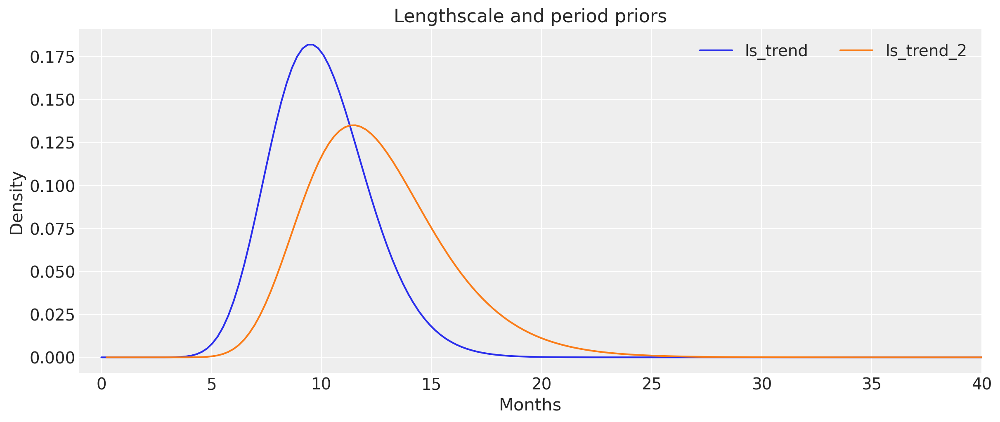

In [41]:
x = np.linspace(0, 120, 500)
priors = [
    ("ls_trend", pm.Gamma.dist(alpha=20, beta=2)),
    ("ls_trend_2", pm.Lognormal.dist(mu=2.5, sigma=0.25)),
    #("ls_med", pm.Lognormal.dist(mu=0., sigma=0.1)),
]

fig = plt.figure(figsize=(12, 5))

for i, prior in enumerate(priors):
    plt.plot(x, np.exp(prior[1].logp(x).eval()), label=prior[0])

plt.xlim((-1, 40))
plt.xlabel("Months")
plt.ylabel("Density")
plt.title("Lengthscale and period priors")
plt.legend(ncol=3);

Now we have to think about priors for our scale parameters: `amplitude_trend` (the scale of the long term trend), `amplitude_med` (the scale of the short to medium term component), and `amplitude_per` (the scale of the semi-periodic component). We don't have a lot of prior information about these parameters, so let's choose a weakly informative prior:

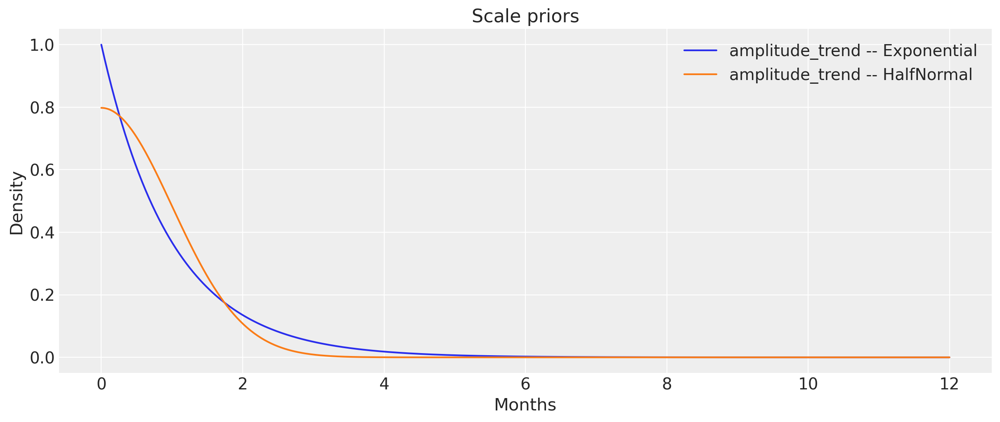

In [9]:
x = np.linspace(0, 12, 500)
priors = [
    ("amplitude_trend -- Exponential", pm.Exponential.dist(1)),
    ("amplitude_trend -- HalfNormal", pm.HalfNormal.dist(1)),
]

fig = plt.figure(figsize=(12, 5))

for i, prior in enumerate(priors):
    plt.plot(x, np.exp(prior[1].logp(x).eval()), label=prior[0])

plt.xlabel("Months")
plt.ylabel("Density")
plt.title("Scale priors")
plt.legend();

And now we can use these priors to simulate samples from the whole GP prior and see if our choices make sense:

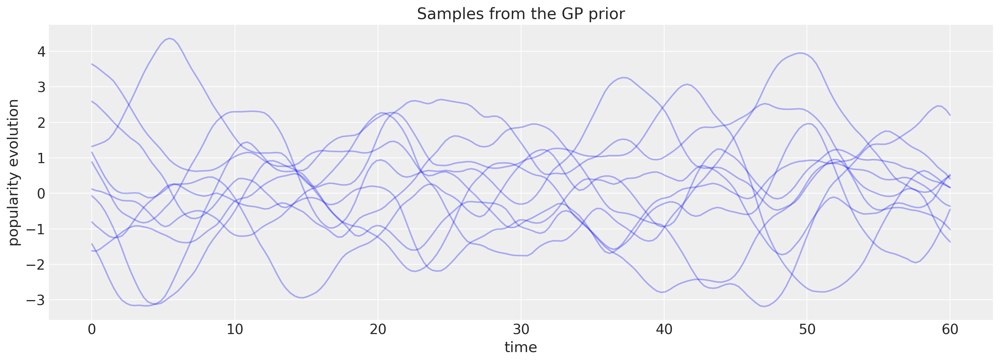

In [17]:
# long term trend
amplitude_trend = pm.HalfNormal.dist(1.0).random(1)
ls_trend = pm.Gamma.dist(alpha=20, beta=1).random(1)
cov_trend = amplitude_trend ** 2 * pm.gp.cov.Matern52(1, ls_trend)

# small/medium term irregularities
amplitude_med = pm.HalfNormal.dist(1.0).random(1)
ls_med = pm.Gamma.dist(alpha=10, beta=2).random(1)
# scale_mixture_rate = pm.Gamma.dist(alpha=5,  beta=2).random(1)
cov_medium = amplitude_med ** 2 * pm.gp.cov.Matern52(1, ls=ls_med)

X = np.linspace(0, 60, 200)[:, None]
cov = cov_trend + cov_medium
K = cov(X).eval()

plt.figure(figsize=(14, 5))
plt.plot(
    X,
    pm.MvNormal.dist(mu=np.zeros(K.shape[0]), cov=K).random(size=10).T,
    color="b",
    alpha=0.3,
)
plt.title("Samples from the GP prior")
plt.xlabel("time")
plt.ylabel("popularity evolution");

Finally, let's pick a prior for our `baseline` parameter, i.e the intercept of our Gaussian Process regression. In other words, this will be the mean function of our GP -- the value it reverts to when data start lacking. There we have quite a lot of information: 50% popularity is historically quite high for a French president (just take a look at the whole dataset we loaded at the beginning of the NB), so keeping the mean at zero is sub-optimal -- remember that `baseline` lives on the logit scale, so a prior centered at 0 means a prior centered at $logistic(0) = 0.5$ on the outcome space. 

We can do better: based on our domain knowledge, we expect most president to have a baseline popularity between 20% and 50% -- in other words, French people rarely love their presidents but often _really_ dislike them. $Normal(-0.7, 0.5)$ looks reasonable in that regard: it expects 95% of the probability mass to be between -1.7 and 0.3, i.e $logistic(-1.7) = 15\%$ and $logistic(0.3) = 57\%$, with a mean approval of $logistic(-0.7) = 33\%$:

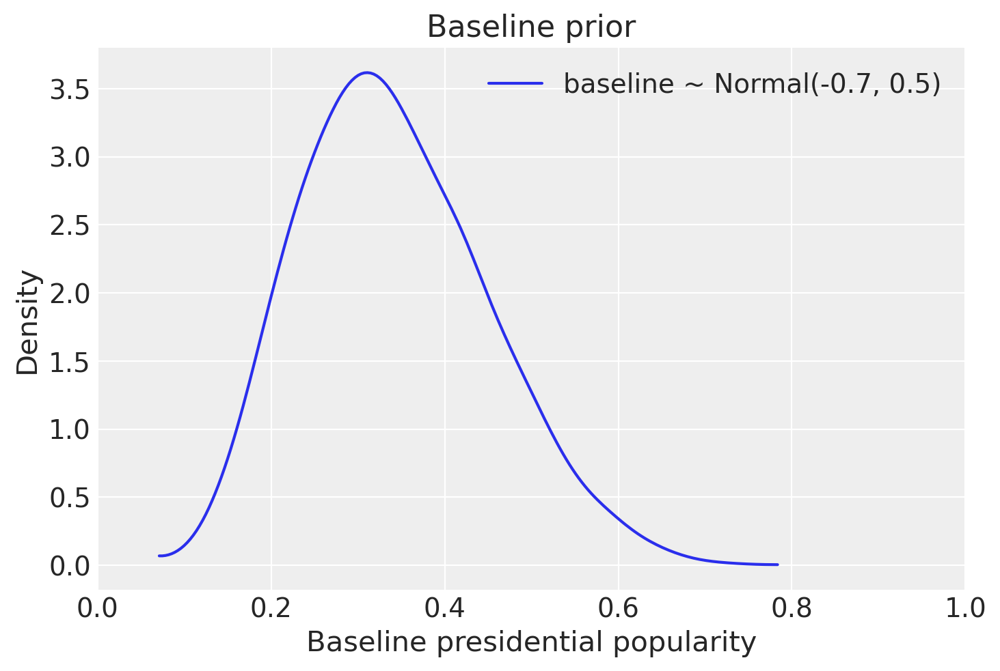

In [22]:
ax = az.plot_kde(
    logistic(pm.Normal.dist(-0.7, 0.5).random(size=20_000)),
    label="baseline ~ Normal(-0.7, 0.5)",
)
ax.set_xlim((0, 1))
ax.set_xlabel("Baseline presidential popularity")
ax.set_ylabel("Density")
ax.set_title("Baseline prior");

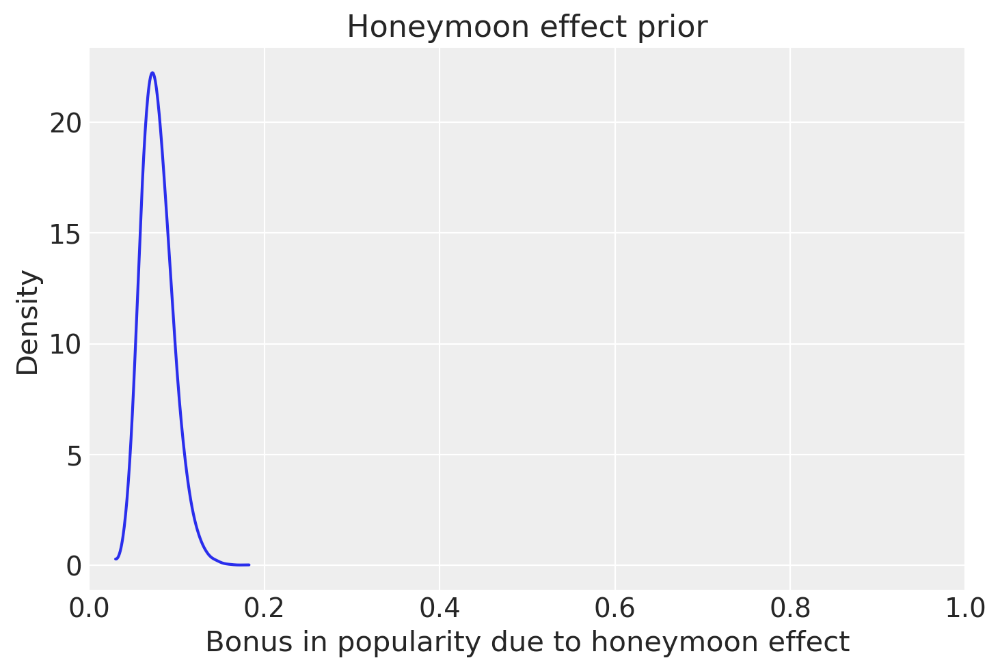

In [23]:
ax = az.plot_kde(logistic(pm.Normal.dist(-2.5, 0.25).random(size=20_000)),)
ax.set_xlim((0, 1))
ax.set_xlabel("Bonus in popularity due to honeymoon effect")
ax.set_ylabel("Density")
ax.set_title("Honeymoon effect prior");

In [9]:
MAX_OBSERVED = len(d.index)
COORDS = {"timesteps": np.arange(MAX_OBSERVED)}

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 8 jobs)
NUTS: [f_time_rotated_, ls_trend, amplitude_trend, honeymoon, baseline]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 1597 seconds.


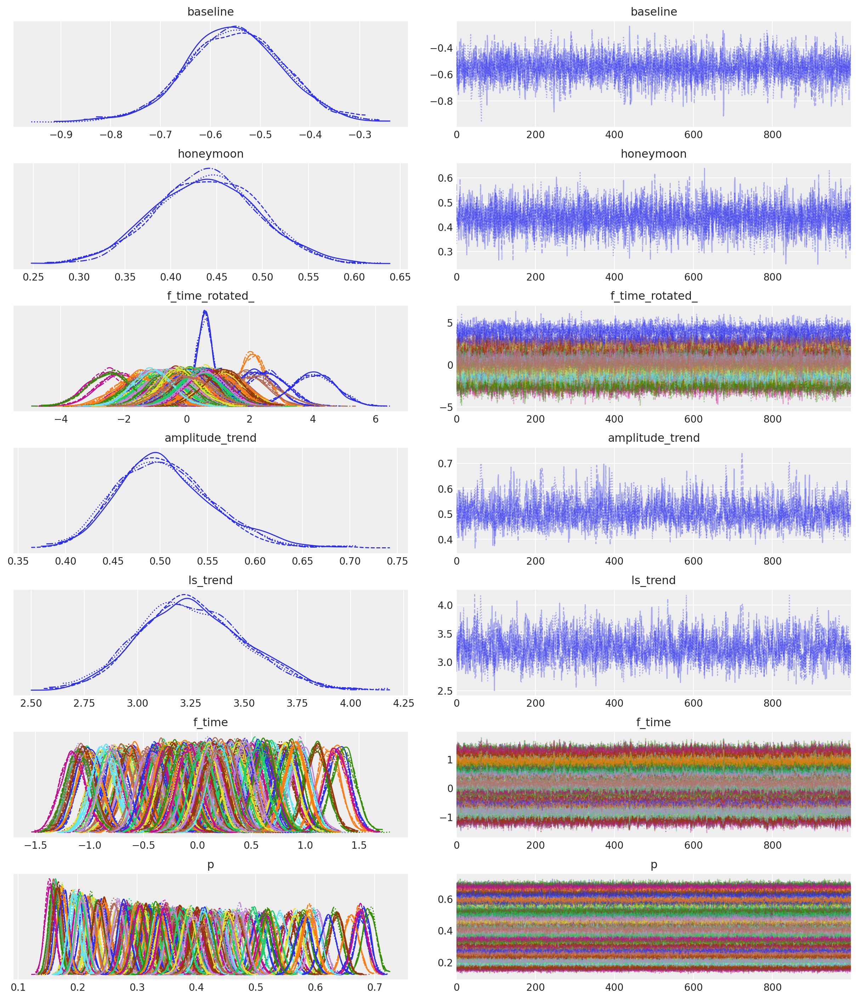

In [25]:
with pm.Model(coords=COORDS) as raw_latent_gp:
    # intercept on logit scale
    baseline = pm.Normal("baseline", -0.7, 0.5)

    # honeymoon slope
    honeymoon = pm.Normal("honeymoon", -2.5, 0.3)

    # long term trend
    amplitude_trend = pm.Exponential("amplitude_trend", 1.0)
    ls_trend = pm.Gamma("ls_trend", alpha=5, beta=2)
    cov_trend = amplitude_trend ** 2 * pm.gp.cov.Matern52(1, ls_trend)

    # instantiate gp
    gp = pm.gp.Latent(cov_func=cov_trend)
    # evaluate GP at time points
    f_time = gp.prior("f_time", X=time[:, None])

    # data
    election_flag = pm.Data("election_flag", d.election_flag.values, dims="timesteps")

    p = pm.Deterministic(
        "p",
        pm.math.invlogit(baseline + f_time + honeymoon * election_flag),
        dims="timesteps",
    )

    y = pm.Binomial("y", p=p, n=d.N_total, observed=d.N_approve, dims="timesteps")

    trace_raw = pm.sample(
        chains=4,
        cores=8,
        return_inferencedata=True,
        idata_kwargs={
            "dims": {"f_time": ["timesteps"], "f_time_rotated_": ["timesteps"]}
        },
    )

az.plot_trace(trace_raw, compact=True);

In [26]:
az.summary(trace_raw, var_names=["~p", "~f_time", "~f_time_rotated_"], round_to=2)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
baseline,-0.55,0.10,-0.72,-0.37,0.00,0.0,3414.75,3280.19,3440.68,2459.29,1.0
honeymoon,0.44,0.06,0.34,0.55,0.00,0.0,5495.89,5457.86,5511.71,3332.59,1.0
amplitude_trend,0.51,0.05,0.42,0.61,0.00,0.0,1709.13,1687.87,1752.84,1965.71,1.0
ls_trend,3.26,0.25,2.82,3.73,0.01,0.0,1401.63,1400.66,1407.92,1856.44,1.0


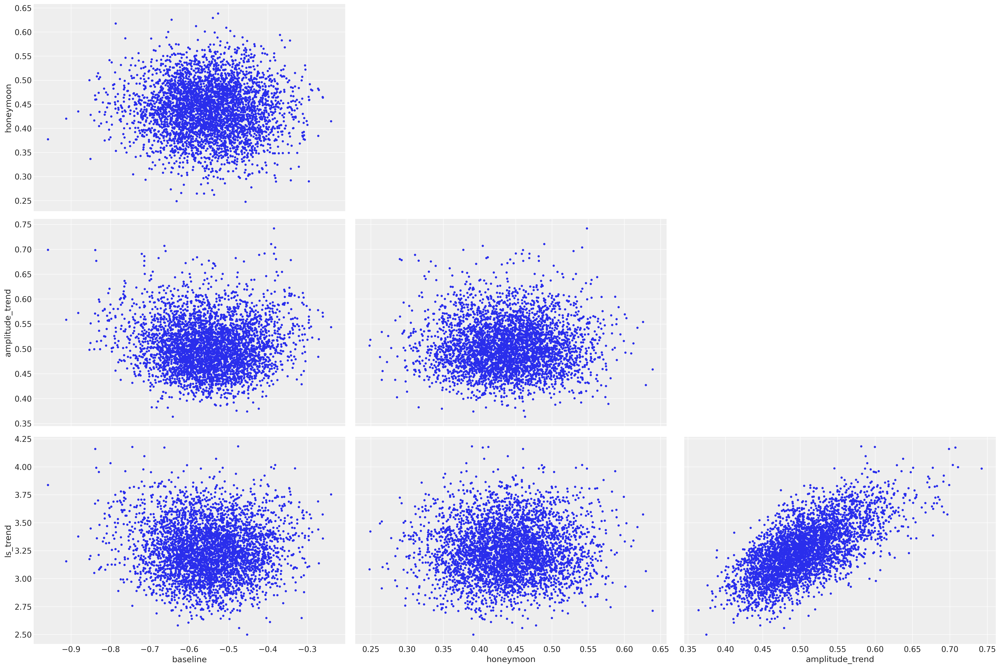

In [27]:
az.plot_pair(trace_raw, var_names=["~p", "~f_time", "~f_time_rotated_"], divergences=True);

In [10]:
TIME_BEFORE_ORIGIN = 24  # 2 years prior any data
MAX_TIME = MAX_OBSERVED + 24  # 2 years out-of-sample
RANGE_OOS = MAX_TIME + TIME_BEFORE_ORIGIN

tnew = np.linspace(-TIME_BEFORE_ORIGIN, MAX_TIME, RANGE_OOS)[:, None]

In [29]:
with raw_latent_gp:
    pm.set_data(
        {
            "election_flag": np.concatenate(
                (
                    np.zeros(TIME_BEFORE_ORIGIN, dtype=int),
                    d.election_flag.values,
                    np.zeros(
                        RANGE_OOS - (MAX_OBSERVED + TIME_BEFORE_ORIGIN), dtype=int
                    ),
                )
            ),
        }
    )
    f_time_new = gp.conditional("f_time_new", Xnew=tnew)

    ppc = pm.sample_posterior_predictive(
        trace_raw.posterior, samples=1000, var_names=["baseline", "f_time_new", "honeymoon"]
    )

    az.from_pymc3_predictions(
        ppc,
        idata_orig=trace_raw,
        inplace=True,
        coords={"timesteps": np.arange(RANGE_OOS)},
        dims={"f_time_new": ["timesteps"]},
    )

trace_raw

/Users/alex_andorra/opt/anaconda3/envs/elections-models/lib/python3.8/site-packages/pymc3/sampling.py:1707: UserWarning: samples parameter is smaller than nchains times ndraws, some draws and/or chains may not be represented in the returned posterior predictive sample
  warnings.warn(


Inference data with groups:
	> posterior
	> predictions
	> log_likelihood
	> sample_stats
	> observed_data
	> constant_data
	> predictions_constant_data

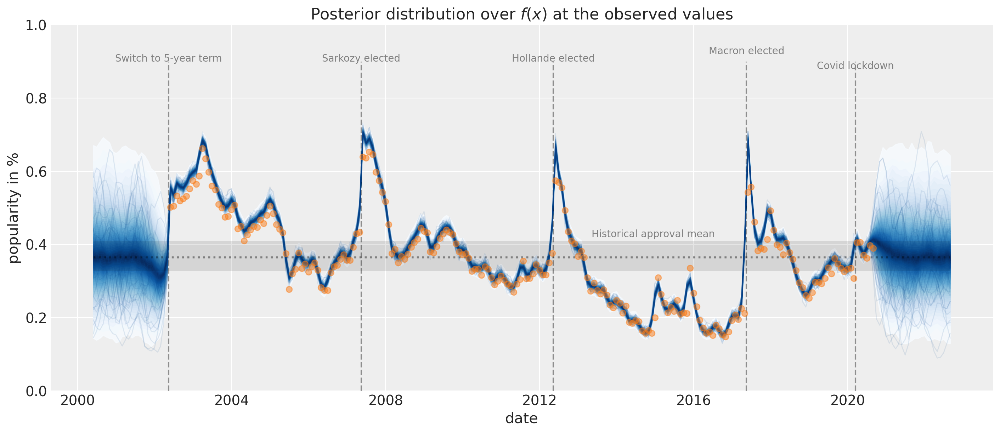

In [30]:
# plot the results
_, ax = plt.subplots(1, 1, figsize=(14, 6))

# plot the samples from the gp posterior with samples and shading
pp_prop = (
    logistic(
        trace_raw.predictions["baseline"]
        + trace_raw.predictions["f_time_new"]
        + trace_raw.predictions["honeymoon"]
        * trace_raw.predictions_constant_data["election_flag"]
    )
    .stack(sample=("chain", "draw"))
    .data.T
)
pp_dates = pd.date_range(
    start=d.index[0] - np.timedelta64(TIME_BEFORE_ORIGIN, "M"),
    periods=RANGE_OOS,
    freq="M",
).values
pm.gp.util.plot_gp_dist(ax, pp_prop, pp_dates, plot_samples=True, palette="Blues")

# plot the data
ax.plot(d.index, d.p_approve.values, "o", color="C1", alpha=0.5)

ax.hlines(
    logistic(trace_raw.predictions["baseline"].mean()),
    pp_dates[0],
    pp_dates[-1],
    "k",
    ":",
    alpha=0.4,
    lw=2,
)
ax.fill_between(
    pp_dates,
    logistic(az.hdi(trace_raw.predictions)["baseline"]).sel(hdi="lower"),
    logistic(az.hdi(trace_raw.predictions)["baseline"]).sel(hdi="higher"),
    color="k",
    edgecolor="none",
    alpha=0.1,
)
ax.text(
    pd.to_datetime("2014-12-14"),
    0.42,
    "Historical approval mean",
    fontsize=10,
    color="grey",
    horizontalalignment="center",
)

ax.vlines(pd.to_datetime("2002-05-14"), 0.0, 0.9, "k", "--", alpha=0.4)
ax.text(
    pd.to_datetime("2002-05-14"),
    0.9,
    "Switch to 5-year term",
    fontsize=10,
    color="grey",
    horizontalalignment="center",
)

ax.vlines(pd.to_datetime("2007-05-16"), 0.0, 0.9, "k", "--", alpha=0.4)
ax.text(
    pd.to_datetime("2007-05-16"),
    0.9,
    "Sarkozy elected",
    fontsize=10,
    color="grey",
    horizontalalignment="center",
)

ax.vlines(pd.to_datetime("2012-05-11"), 0.0, 0.9, "k", "--", alpha=0.4)
ax.text(
    pd.to_datetime("2012-05-11"),
    0.9,
    "Hollande elected",
    fontsize=10,
    color="grey",
    horizontalalignment="center",
)

ax.vlines(pd.to_datetime("2017-05-17"), 0.0, 0.9, "k", "--", alpha=0.4)
ax.text(
    pd.to_datetime("2017-05-17"),
    0.92,
    "Macron elected",
    fontsize=10,
    color="grey",
    horizontalalignment="center",
)

ax.vlines(pd.to_datetime("2020-03-17"), 0.0, 0.9, "k", "--", alpha=0.4)
ax.text(
    pd.to_datetime("2020-03-17"),
    0.88,
    "Covid lockdown",
    fontsize=10,
    color="grey",
    horizontalalignment="center",
)

# axis labels and title
ax.set_ylim((0, 1))
ax.set_xlabel("date")
ax.set_ylabel("popularity in %")
ax.set_title("Posterior distribution over $f(x)$ at the observed values");

> we can write a gamma population model in a centered parameterization:

$$theta_{n} ~ gamma(alpha, beta)$$

> or a non-centered parameterization:

$$tilde{theta}_{n} ~ gamma(alpha, 1)$$
$$theta_{n} = tilde{theta} / beta$$

> Note that we can only non-center the rate parameter, beta. The shape parameter, alpha, cannot be transformed away, limiting the utility of non-centering relative to the normal case. To avoid this limitation positive population models are often modeled with a log normal transformation so that the log parameter can be fully centered and non-centered.

([from Michael Betancourt](https://www.patreon.com/posts/march-questions-35409336))

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 8 jobs)
NUTS: [f_time_rotated_, log_ls_med, amplitude_med, ls_trend, amplitude_trend, honeymoon, baseline]


Sampling 4 chains for 1_500 tune and 1_000 draw iterations (6_000 + 4_000 draws total) took 2749 seconds.
There were 25 divergences after tuning. Increase `target_accept` or reparameterize.
There were 3 divergences after tuning. Increase `target_accept` or reparameterize.
There were 7 divergences after tuning. Increase `target_accept` or reparameterize.
There were 28 divergences after tuning. Increase `target_accept` or reparameterize.
The estimated number of effective samples is smaller than 200 for some parameters.


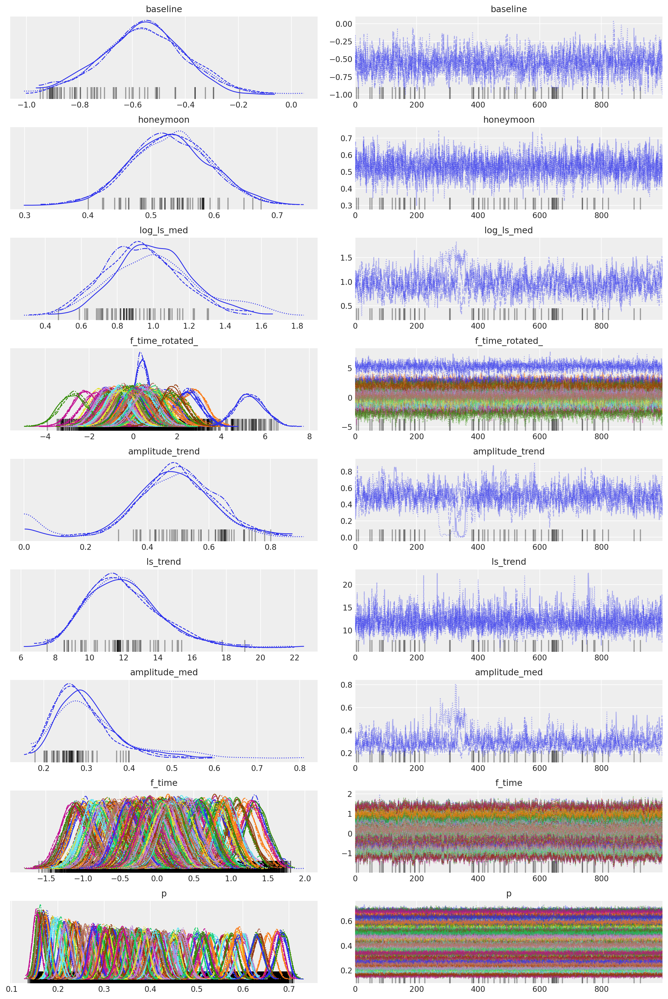

In [49]:
# economy: GRW, or just uncertainty in x?
# uncertainty in y OR overdispersion
# parameters identifiable?

with pm.Model(coords=COORDS) as finer_latent_gp:
    # intercept on logit scale
    baseline = pm.Normal("baseline", -0.7, 0.5)

    # honeymoon slope
    #honeymoon = pm.Normal("honeymoon", -2.5, 0.3)
    honeymoon = pm.Normal("honeymoon", 0., 0.5)

    # long term trend
    amplitude_trend = pm.HalfNormal("amplitude_trend", 1.)
    ls_trend = pm.Gamma("ls_trend", alpha=20, beta=2)
    # ls_trend = pm.Lognormal("ls_trend", mu=2.5, sigma=0.2)
    cov_trend = amplitude_trend ** 2 * pm.gp.cov.Matern52(1, ls_trend)
    gp_trend = pm.gp.Latent(cov_func=cov_trend)

    # small/medium term irregularities
    amplitude_med = pm.HalfNormal("amplitude_med", 0.5)
    # ls_med = pm.Gamma("ls_med", alpha=7, beta=2)
    #ls_med = pm.Gamma("ls_med", alpha=2, beta=0.5)
    ls_med = pm.Lognormal("ls_med", mu=0., sigma=0.1)
    #log_ls_med = pm.Normal("log_ls_med", mu=0., sigma=1.)
    #ls_med = tt.exp(log_ls_med)
    cov_medium = amplitude_med ** 2 * pm.gp.cov.Matern32(1, ls_med)
    gp_medium = pm.gp.Latent(cov_func=cov_medium)

    # The Gaussian process is a sum of these two components
    gp = gp_trend + gp_medium
    # evaluate GP at time points
    f_time = gp.prior("f_time", X=time[:, None])

    # data
    election_flag = pm.Data("election_flag", d.election_flag.values, dims="timesteps")

    p = pm.Deterministic(
        "p",
        pm.math.invlogit(baseline + f_time + honeymoon * election_flag),
        dims="timesteps",
    )
    y = pm.Binomial("y", p=p, n=d.N_total, observed=d.N_approve, dims="timesteps")

    trace_finer = pm.sample(
        tune=1500,
        cores=8,
        chains=4,
        return_inferencedata=True,
        idata_kwargs={
            "dims": {"f_time": ["timesteps"], "f_time_rotated_": ["timesteps"]}
        },
    )
    
#az.to_netcdf(trace_finer, "trace_finer_raw.nc")
az.plot_trace(trace_finer, compact=True);

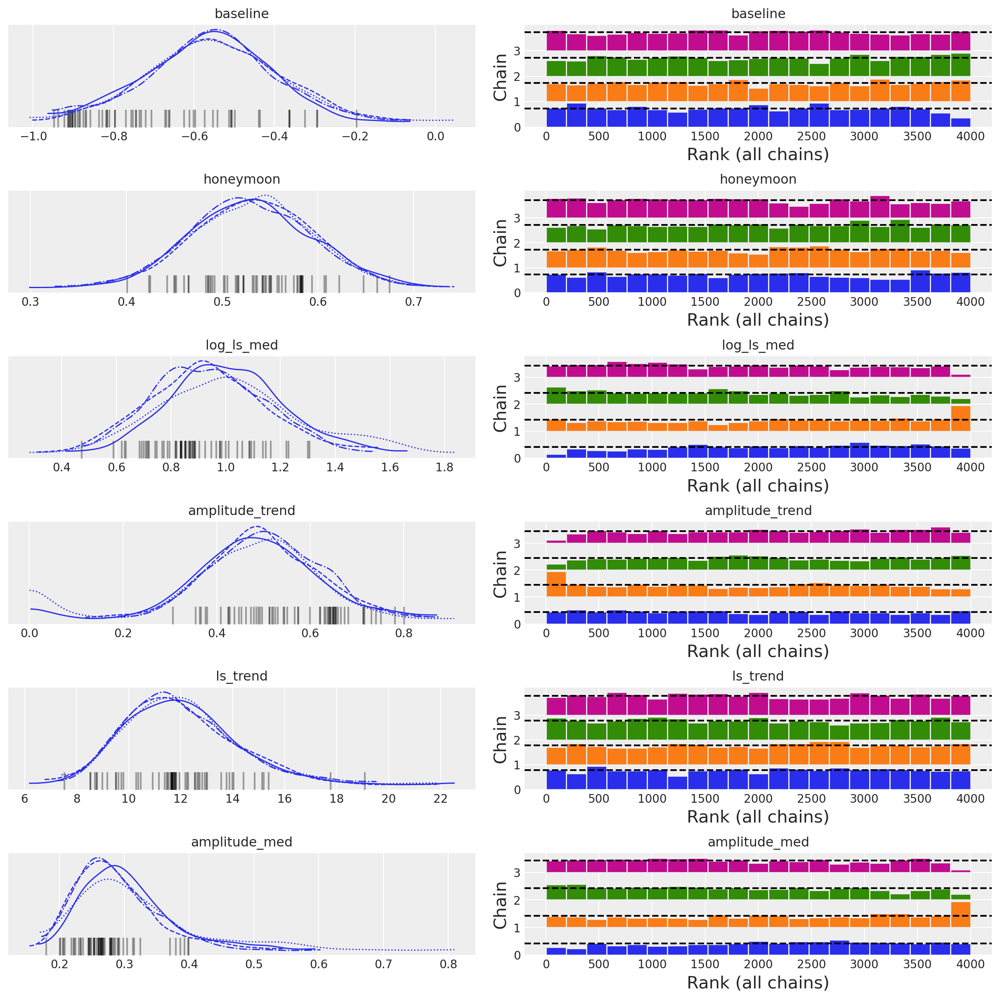

In [50]:
az.plot_trace(trace_finer, compact=True, kind="rank_bars", var_names=["~p", "~f_time", "~f_time_rotated_"]);

In [51]:
az.summary(trace_finer, var_names=["~p", "~f_time", "~f_time_rotated_"], round_to=2)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
baseline,-0.56,0.16,-0.87,-0.26,0.00,0.00,1250.49,1160.28,1262.34,964.53,1.00
honeymoon,0.53,0.06,0.42,0.66,0.00,0.00,2320.31,2278.63,2323.09,2561.80,1.00
log_ls_med,0.98,0.22,0.57,1.42,0.02,0.02,135.25,109.12,157.94,101.98,1.03
amplitude_trend,0.48,0.14,0.26,0.76,0.01,0.01,126.27,126.27,223.76,85.89,1.02
ls_trend,12.01,2.14,8.42,16.23,0.04,0.03,2741.61,2612.41,2886.29,2713.34,1.00
amplitude_med,0.30,0.07,0.18,0.44,0.01,0.01,122.62,102.20,221.96,104.32,1.03


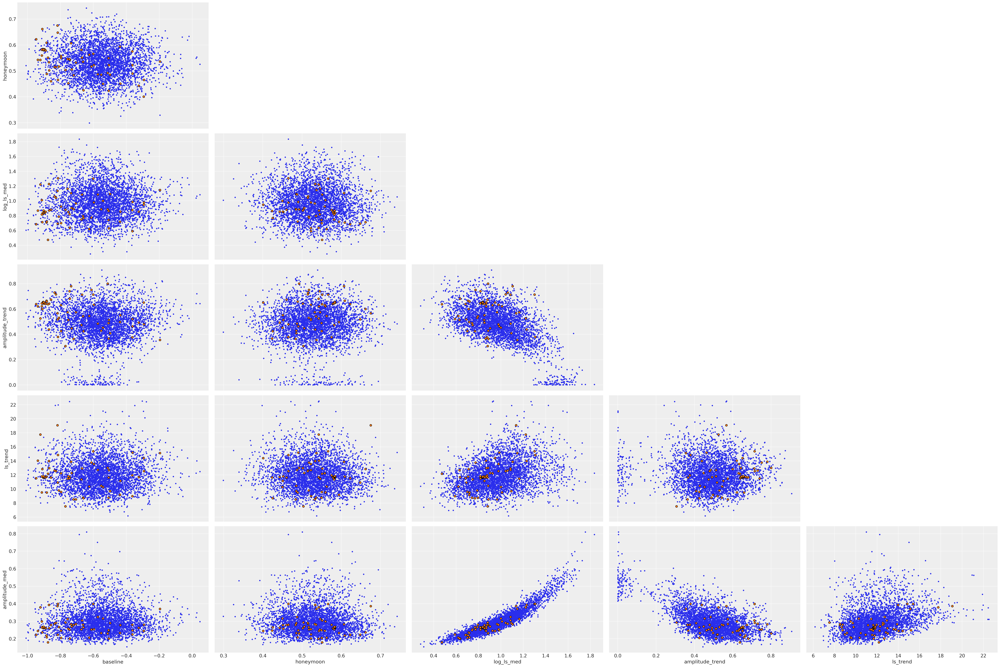

In [52]:
az.plot_pair(trace_finer, var_names=["~p", "~f_time", "~f_time_rotated_"], divergences=True);

/Users/alex_andorra/opt/anaconda3/envs/elections-models/lib/python3.8/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


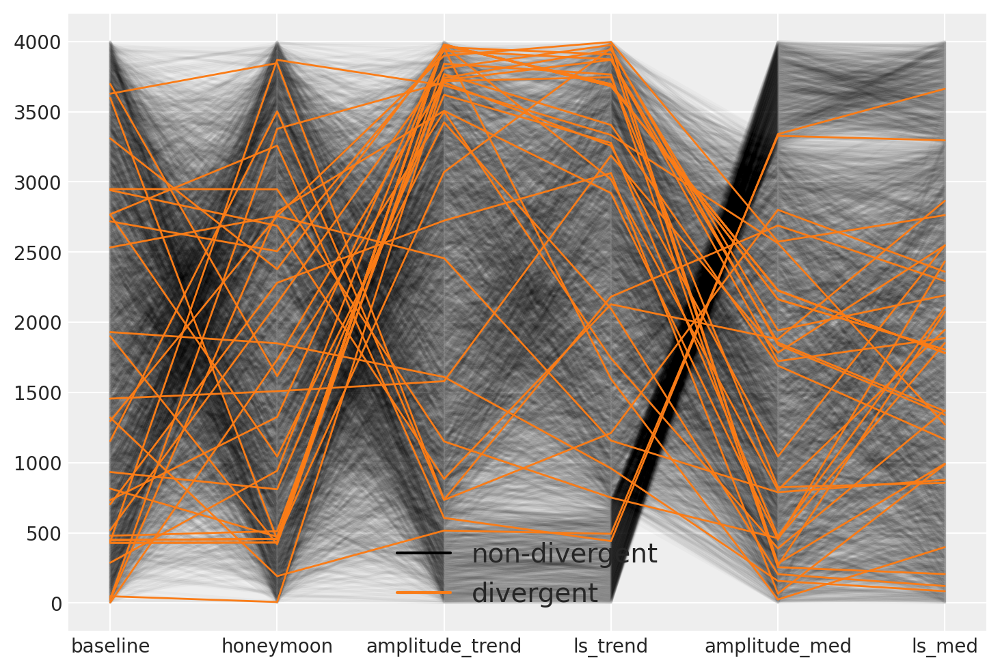

In [116]:
az.plot_parallel(trace_finer, var_names=["~p", "~f_time", "~f_time_rotated_"], norm_method="rank");

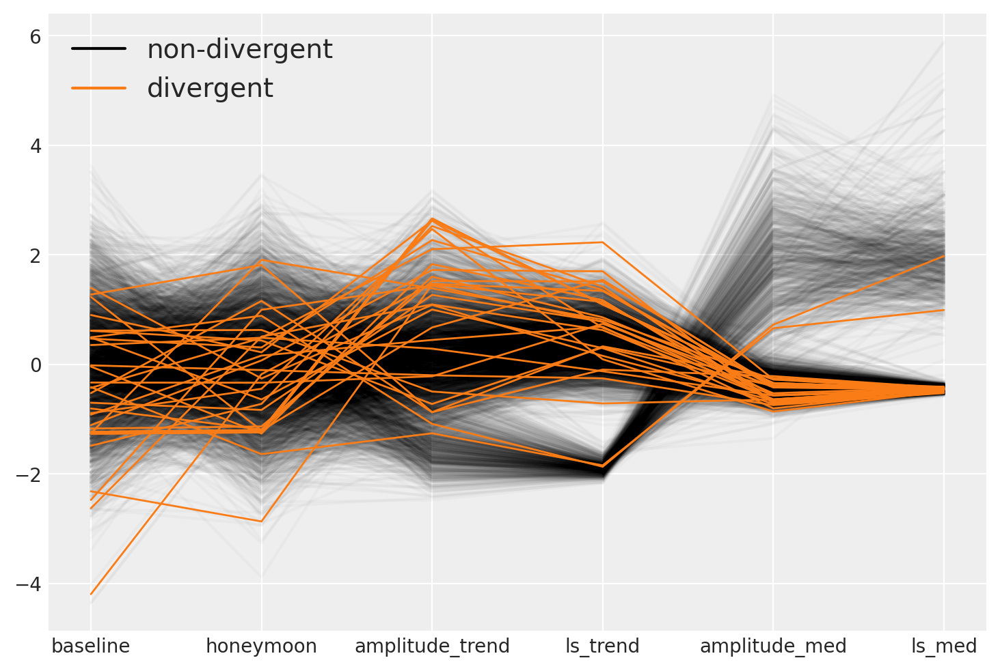

In [117]:
az.plot_parallel(trace_finer, var_names=["~p", "~f_time", "~f_time_rotated_"], norm_method="normal");

/Users/alex_andorra/opt/anaconda3/envs/elections-models/lib/python3.8/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


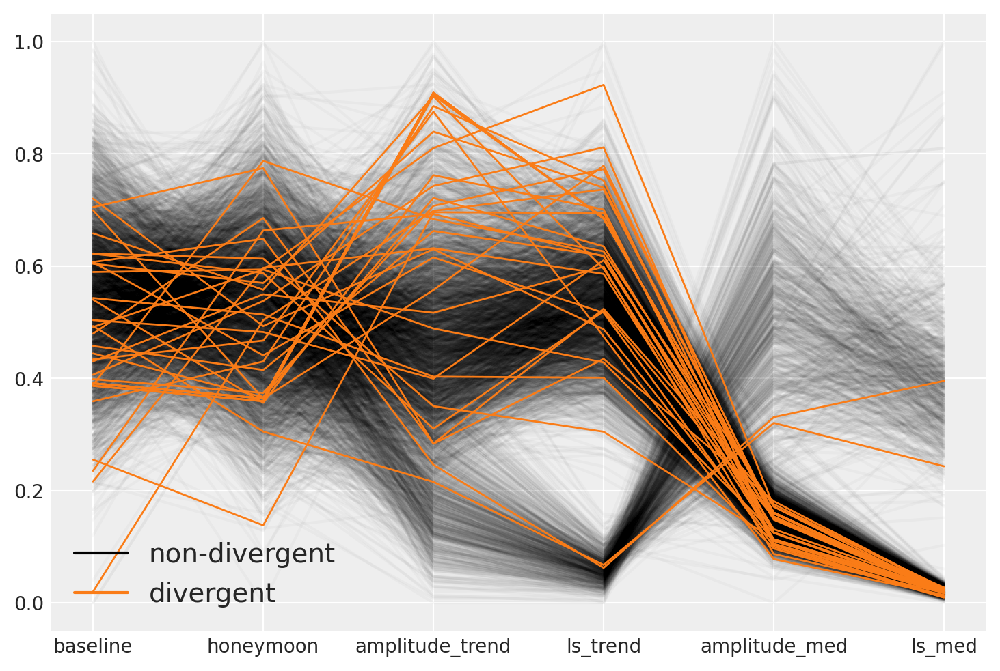

In [118]:
az.plot_parallel(trace_finer, var_names=["~p", "~f_time", "~f_time_rotated_"], norm_method="minmax");

In [36]:
with finer_latent_gp:
    pm.set_data(
        {
            "election_flag": np.concatenate(
                (
                    np.zeros(TIME_BEFORE_ORIGIN, dtype=int),
                    d.election_flag.values,
                    np.zeros(
                        RANGE_OOS - (MAX_OBSERVED + TIME_BEFORE_ORIGIN), dtype=int
                    ),
                )
            ),
        }
    )
    f_time_new = gp.conditional("f_time_new", Xnew=tnew)

    ppc = pm.sample_posterior_predictive(
        trace_finer.posterior, samples=1000, var_names=["baseline", "f_time_new", "honeymoon"]
    )

    az.from_pymc3_predictions(
        ppc,
        idata_orig=trace_finer,
        inplace=True,
        coords={"timesteps": np.arange(RANGE_OOS)},
        dims={"f_time_new": ["timesteps"]},
    )

trace_finer

/Users/alex_andorra/opt/anaconda3/envs/elections-models/lib/python3.8/site-packages/pymc3/sampling.py:1707: UserWarning: samples parameter is smaller than nchains times ndraws, some draws and/or chains may not be represented in the returned posterior predictive sample
  warnings.warn(


Inference data with groups:
	> posterior
	> predictions
	> log_likelihood
	> sample_stats
	> observed_data
	> constant_data
	> predictions_constant_data

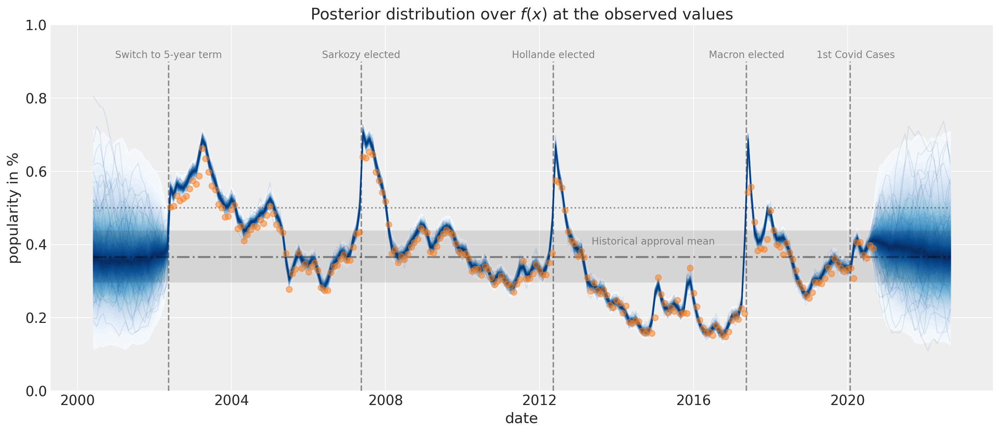

In [41]:
# plot the results
_, ax = plt.subplots(1, 1, figsize=(14, 6))

# plot the samples from the gp posterior with samples and shading
pp_prop = (
    logistic(
        trace_finer.predictions["baseline"]
        + trace_finer.predictions["f_time_new"]
        + trace_finer.predictions["honeymoon"]
        * trace_finer.predictions_constant_data["election_flag"]
    )
    .stack(sample=("chain", "draw"))
    .data.T
)
pp_dates = pd.date_range(
    start=d.index[0] - np.timedelta64(TIME_BEFORE_ORIGIN, "M"),
    periods=RANGE_OOS,
    freq="M",
).values
pm.gp.util.plot_gp_dist(ax, pp_prop, pp_dates, plot_samples=True, palette="Blues")

# plot the data
ax.plot(d.index, d.p_approve.values, "o", color="C1", alpha=0.5)

# plot historical baseline
ax.hlines(
    logistic(trace_finer.predictions["baseline"].mean()),
    pp_dates[0],
    pp_dates[-1],
    "k",
    "-.",
    alpha=0.4,
    lw=2,
)
ax.fill_between(
    pp_dates,
    logistic(az.hdi(trace_finer.predictions)["baseline"]).sel(hdi="lower"),
    logistic(az.hdi(trace_finer.predictions)["baseline"]).sel(hdi="higher"),
    color="k",
    edgecolor="none",
    alpha=0.1,
)
ax.text(
    pd.to_datetime("2014-12-14"),
    0.4,
    "Historical approval mean",
    fontsize=10,
    color="grey",
    horizontalalignment="center",
)

# annotate graph
ax.hlines(
    0.5,
    pp_dates[0],
    pp_dates[-1],
    "k",
    ":",
    alpha=0.4,
)

ax.vlines(pd.to_datetime("2002-05-14"), 0.0, 0.9, "k", "--", alpha=0.4)
ax.text(
    pd.to_datetime("2002-05-14"),
    0.91,
    "Switch to 5-year term",
    fontsize=10,
    color="grey",
    horizontalalignment="center",
)

ax.vlines(pd.to_datetime("2007-05-16"), 0.0, 0.9, "k", "--", alpha=0.4)
ax.text(
    pd.to_datetime("2007-05-16"),
    0.91,
    "Sarkozy elected",
    fontsize=10,
    color="grey",
    horizontalalignment="center",
)

ax.vlines(pd.to_datetime("2012-05-11"), 0.0, 0.9, "k", "--", alpha=0.4)
ax.text(
    pd.to_datetime("2012-05-11"),
    0.91,
    "Hollande elected",
    fontsize=10,
    color="grey",
    horizontalalignment="center",
)

ax.vlines(pd.to_datetime("2017-05-17"), 0.0, 0.9, "k", "--", alpha=0.4)
ax.text(
    pd.to_datetime("2017-05-17"),
    0.91,
    "Macron elected",
    fontsize=10,
    color="grey",
    horizontalalignment="center",
)

ax.vlines(pd.to_datetime("2020-01-24"), 0.0, 0.9, "k", "--", alpha=0.4)
ax.text(
    pd.to_datetime("2020-03-17"),
    0.91,
    "1st Covid Cases",
    fontsize=10,
    color="grey",
    horizontalalignment="center",
)

# axis labels and title
ax.set_ylim((0, 1))
ax.set_xlabel("date")
ax.set_ylabel("popularity in %")
ax.set_title("Posterior distribution over $f(x)$ at the observed values");